In [43]:
df.style.set_table_styles([{'selector': 'tr:hover', 'props': [('background-color', 'yellow')]}])

,step,type,amount,nameOrig,oldbalanceOrg,newbalanceOrig,nameDest,oldbalanceDest,newbalanceDest,isFraud,isFlaggedFraud
0,1,PAYMENT,9839.640000,C1231006815,170136.000000,160296.360000,M1979787155,0.000000,0.000000,0,0
1,1,PAYMENT,1864.280000,C1666544295,21249.000000,19384.720000,M2044282225,0.000000,0.000000,0,0
2,1,TRANSFER,181.000000,C1305486145,181.000000,0.000000,C553264065,0.000000,0.000000,1,0
3,1,CASH_OUT,181.000000,C840083671,181.000000,0.000000,C38997010,21182.000000,0.000000,1,0
4,1,PAYMENT,11668.140000,C2048537720,41554.000000,29885.860000,M1230701703,0.000000,0.000000,0,0
5,1,PAYMENT,7817.710000,C90045638,53860.000000,46042.290000,M573487274,0.000000,0.000000,0,0
6,1,PAYMENT,7107.770000,C154988899,183195.000000,176087.230000,M408069119,0.000000,0.000000,0,0
7,1,PAYMENT,7861.640000,C1912850431,176087.230000,168225.590000,M633326333,0.000000,0.000000,0,0
8,1,PAYMENT,4024.360000,C1265012928,2671.000000,0.000000,M1176932104,0.000000,0.000000,0,0
9,1,DEBIT,5337.770000,C712410124,41720.000000,36382.230000,C195600860,41898.000000,40348.790000,0,0


Exercise 1:
               step        amount  oldbalanceOrg  newbalanceOrig  \
count  200000.00000  2.000000e+05   2.000000e+05    2.000000e+05   
mean       10.06589  1.808112e+05   8.821957e+05    9.001938e+05   
std         2.12174  3.291800e+05   2.766264e+06    2.803759e+06   
min         1.00000  3.200000e-01   0.000000e+00    0.000000e+00   
25%         9.00000  1.201612e+04   0.000000e+00    0.000000e+00   
50%        10.00000  6.872104e+04   1.951000e+04    0.000000e+00   
75%        12.00000  2.290791e+05   1.915686e+05    2.275212e+05   
max        13.00000  1.000000e+07   3.893942e+07    3.894623e+07   

       oldbalanceDest  newbalanceDest        isFraud  isFlaggedFraud  
count    2.000000e+05    2.000000e+05  200000.000000        200000.0  
mean     9.411592e+05    1.191866e+06       0.000735             0.0  
std      2.373010e+06    2.655236e+06       0.027101             0.0  
min      0.000000e+00    0.000000e+00       0.000000             0.0  
25%      0.000000e+0

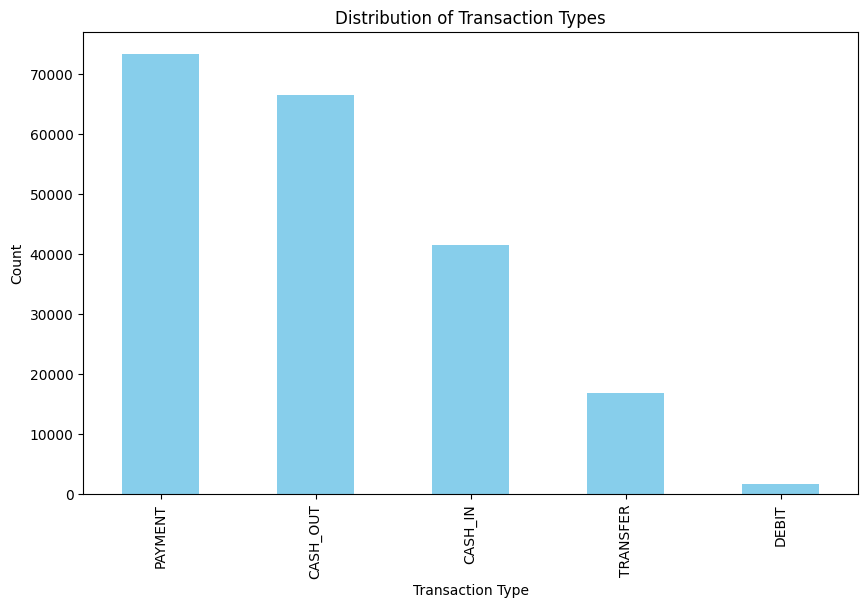

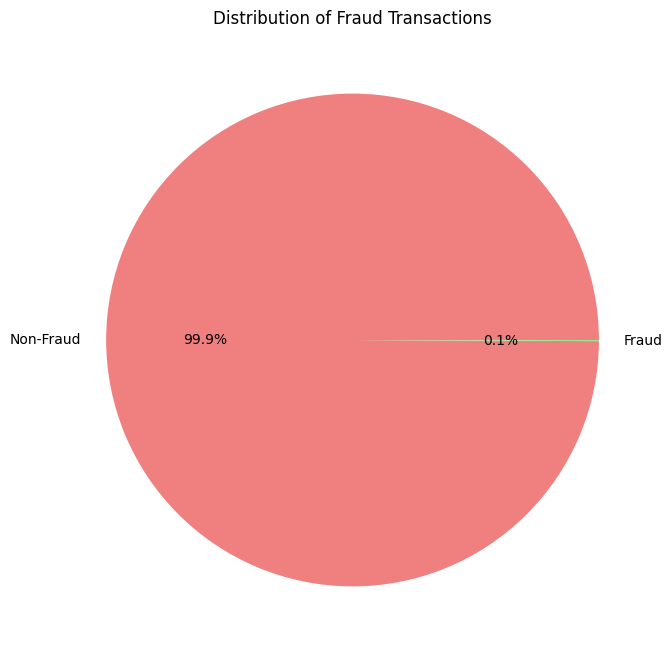


Exercise Custom:
type
CASH_IN     181127.098924
CASH_OUT    202707.250339
DEBIT         9067.533012
PAYMENT      12044.891884
TRANSFER    846637.381022
Name: amount, dtype: float64


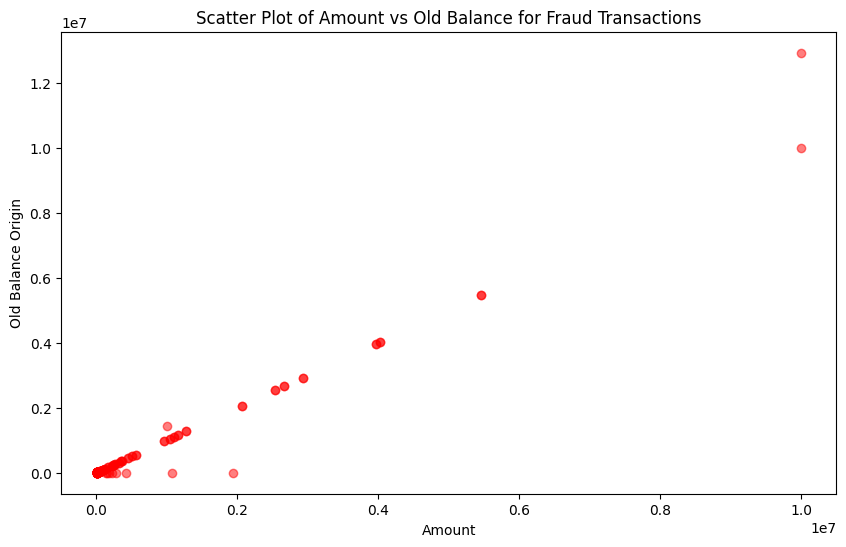

In [66]:
import pandas as pd
import matplotlib.pyplot as plt

# Exercise functions
def exercise_0(file):
    df = pd.read_csv(file)
    return df

def exercise_1(df):
    return df.describe()

def exercise_2(df, k):
    payment_df = df[df['type'] == k]
    return payment_df

def exercise_3(df, k):
    result_df = df[df['amount'] > k]
    return result_df

def exercise_4(df):
    isFraud_df = df.sort_values(by='isFraud', ascending=False) 
    return isFraud_df

def exercise_5(df):
    flagFraud_df = df.sort_index()
    return flagFraud_df

def exercise_6(df):
    correlations_df = df[['oldbalanceOrg', 'newbalanceOrig', 'newbalanceDest', 'amount', 'isFraud']].corr()
    return correlations_df

def exercise_7(df):
    total_fraud_loss = df[df['isFraud'] > 0]['amount'].sum()
    return total_fraud_loss

# Visual functions
def visual_1(df):
    transaction_counts = df['type'].value_counts()
    
    plt.figure(figsize=(10, 6))
    transaction_counts.plot(kind='bar', color='skyblue')
    plt.title('Distribution of Transaction Types')
    plt.xlabel('Transaction Type')
    plt.ylabel('Count')
    plt.show()

def visual_2(df):
    fraud_counts = df['isFraud'].value_counts()
    
    plt.figure(figsize=(8, 8))
    plt.pie(fraud_counts, labels=['Non-Fraud', 'Fraud'], autopct='%1.1f%%', colors=['lightcoral', 'lightgreen'])
    plt.title('Distribution of Fraud Transactions')
    plt.show()

def exercise_custom(df):
    result_custom = df.groupby('type')['amount'].mean()
    return result_custom

def visual_custom(df):
    fraud_data = df[df['isFraud'] == 1]
    plt.figure(figsize=(10, 6))
    plt.scatter(fraud_data['amount'], fraud_data['oldbalanceOrg'], color='red', alpha=0.5)
    plt.title('Scatter Plot of Amount vs Old Balance for Fraud Transactions')
    plt.xlabel('Amount')
    plt.ylabel('Old Balance Origin')
    plt.show()

# File name
file_name = 'transactions.csv'

# Read the CSV file into a DataFrame
df = exercise_0(file_name)

# Calling functions exercise and displaying results
result_1 = exercise_1(df)
print("Exercise 1:")
print(result_1)

result_2 = exercise_2(df, 'TRANSFER')
print("\nExercise 2:")
print(result_2)

result_3 = exercise_3(df, 10000)
print("\nExercise 3:")
print(result_3)

result_4 = exercise_4(df)
print("\nExercise 4:")
print(result_4)

result_5 = exercise_5(df)
print("\nExercise 5:")
print(result_5)

result_6 = exercise_6(df)
print("\nExercise 6:")
print(result_6)

result_7 = exercise_7(df)
print("\nExercise 7:")
print(result_7)

# Calling functions visual and displaying results
visual_1(df)
visual_2(df)

# Calling functions custom exercise and displaying results
resultExc_cust = exercise_custom(df)
print("\nExercise Custom:")
print(resultExc_cust)

# Calling functions custom visual and displaying results
visual_custom(df)
